In [1]:
%load_ext autoreload
%autoreload 2

import logging
logging.basicConfig(format='%(message)s', level=logging.INFO)
import pickle

from ipywidgets import fixed, IntSlider, interact_manual

import pyro
pyro.enable_validation(True)
import pyro.distributions as dist
from pyro.infer import Predictive, TraceGraph_ELBO

from scipy.stats import norm

import torch
from torch.distributions import constraints
from torch import nn

from matplotlib import pyplot as plt

In [2]:
import sys
sys.path.append('./')

In [3]:
from src.visualization import (
    plot_ols,
    plot_single_prediction,
    plot_predictions,
    plot_mpd,
    make_interavtive
)
from src.utils import (
    make_ols,
    display_sourcecode,
    run_mcmc,
    sample_mcmc,
    summary,
    run_svi,
    SviPredictive,
    print_summary,
    sample_svi
)

In [4]:
with open('./data/linear-regression.pkl', 'rb') as f:
    data = pickle.load(f)
x_train = data['x_train']
y_train = data['y_train']
x_test = data['x_test']
y_test = data['y_test']

# Linear Regression with Ordinary Least Squares

Task: Predict log GDP per capita of a nation as a function of whether the nation is in Africa, and its Terrain Ruggedness Index.

$$ y_i = x_i^\intercal \beta + \epsilon_i $$

- What are the assumptions?
(Not obligatory)
   - Strict exogeneity - should have conditional mean zero:
   $$ \mathbb{E}[\epsilon_i | x_i] = 0 $$
   what implies $ \mathbb{E}[\epsilon_i] = 0 $, and that the regressors are uncorrelated with the errors
   - Constant variance (homoscedasticity) of $\epsilon_i$ across all values of the response (output) variable
   - No autocorrelation on errors - $ \mathbb{E}[\epsilon_i \epsilon_j | X] = 0 $ for $i \neq j$
   - Lack of perfect multicollinearity in the predictor variables - the matrix $X$ must have full column rank $p$
   - (Not needed for OLS but usefull to establish finite-sample properties) Normality of errors - $ \epsilon | X \sim \mathcal{N}(0, \sigma^2 \mathrm{I}_n) $
- Confidence and Prediction intervals
   1. Mean respons value
   $$ \hat{y}_i = x_i^\intercal \hat{\beta} $$
   We are interested in $\mathbb{E}[y_i | x_i]$.
   2. The actual respons value
   $$ \hat{y}_i = x_i^\intercal \hat{\beta} + \epsilon_i $$
   We are interested in $y_i | x_i$.
 
   - Confidence Intervals are for the mean respons (usually one looks at these)
   $$ \mathrm{Var}[\hat{y}_i] =  \mathrm{Var}[x_i^\intercal \hat{\beta}] = \sigma^2 x_i^\intercal \left( X^\intercal X \right)^{-1}x_i $$
   $$ \hat{y_i} \pm t_{n-p}^{\alpha / 2} \sigma \sqrt{x_i^\intercal \left( X^\intercal X \right)^{-1}x_i} $$ 
   
   - Prediction Intervals are for the actual respons (what we are interested in when considering uncertainty)
   $$ \mathrm{Var}[\hat{y}_i] = \mathrm{Var}[x_i^\intercal \hat{\beta} + \epsilon_i] = \mathrm{Var}[x_i^\intercal \hat{\beta} + (y_i -  x_i^\intercal \beta)] =  \mathrm{Var}[x_i^\intercal \hat{\beta} + y_i] = \sigma^2 \left(x_i^\intercal \left( X^\intercal X \right)^{-1}x_i + 1\right) $$
   $$ \hat{y_i} \pm t_{n-p}^{\alpha / 2} \sigma \sqrt{x_i^\intercal \left( X^\intercal X \right)^{-1}x_i + 1} $$

In [5]:
ols_train, ols_test, beta = make_ols(x_train, y_train, x_test)

In [6]:
beta

tensor([-0.2756,  0.1390,  0.1120,  0.0515,  0.0199,  0.0871,  0.5133,  0.2192])

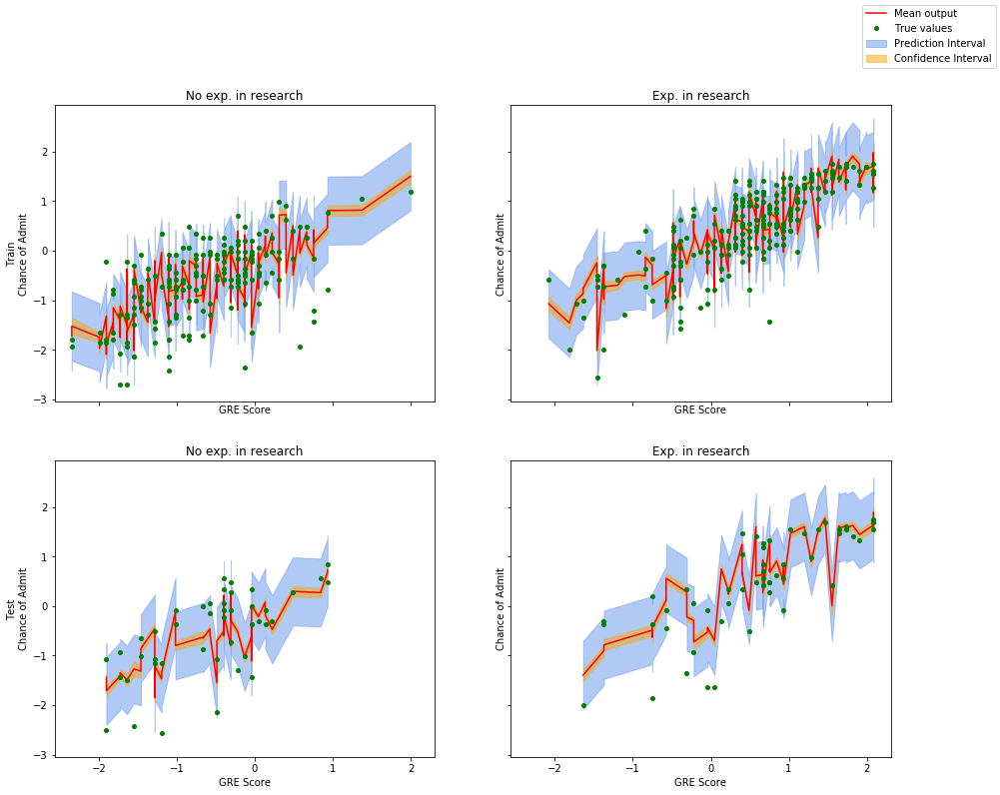

In [7]:
properties = {
    'x': 0,
    'x_label': "GRE Score",
    'y_label': "Chance of Admit",
    'category': 6,
    'category_labels': {
        0: "No exp. in research",
        1: "Exp. in research",
    }
}

data = {
    'Train': {
        'ols': ols_train,
        'x': x_train,
        'y': y_train
    },
    'Test': {
        'ols': ols_test,
        'x': x_test,
        'y': y_test
    }
}
   
plot_ols(data, properties)

# Bayesian Linear Regression

We formulate Bayesian linear regression using probability distributions rather than point estimates. The response, $y$, is not estimated as a single value, but is assumed to be drawn from a probability distribution. 

$$ y \sim \mathcal{N}(\beta^\intercal X, \sigma^2 \mathrm{I}) $$

The Bayesian analogy Confidence Intervals are [Credible Intervals](https://en.wikipedia.org/wiki/Credible_interval).

[Analytical solution](https://en.wikipedia.org/wiki/Bayesian_linear_regression#With_conjugate_priors)

# The Model
Can be initialized with estimate from OLS or with non-informative prior.

In [11]:
def model(x, y=None):
    intercept = pyro.sample("intercept", dist.Normal(beta[0], 10))
    b_GRE = pyro.sample("b_GRE", dist.Normal(beta[1], 1))
    b_TEOFL = pyro.sample("b_TEOFL", dist.Normal(beta[2], 1))
    b_university = pyro.sample("b_university", dist.Normal(beta[3], 1))
    b_SOP = pyro.sample("b_SOP", dist.Normal(beta[4], 1))
    b_LOP = pyro.sample("b_LOP", dist.Normal(beta[5], 1))
    b_CGPA = pyro.sample("b_CGPA", dist.Normal(beta[6], 1))
    b_research = pyro.sample("b_research", dist.Normal(beta[7], 1))

    sigma = pyro.sample("sigma", dist.Exponential(1))
    
    mean = (
            intercept +
            b_GRE * x[:, 0] +
            b_TEOFL * x[:, 1] +
            b_university * x[:, 2] +
            b_SOP * x[:, 3] +
            b_LOP * x[:, 4] +
            b_CGPA * x[:, 5] +
            b_research * x[:, 6]
    )
    with pyro.plate("data", x.shape[0]):
        pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
    return mean

## Markov Chain Monte Carlo

In [12]:
from pyro.infer import NUTS, HMC

In [13]:
num_chains = 1
num_samples = 1_000

### Hamiltonian Monte Carlo

In [14]:
hmc_kernel = HMC(
    model=model,
    num_steps=20,
    step_size=1e-4,
    adapt_step_size=False,
)

hmc_mcmc_posterior = run_mcmc(
    kernel=hmc_kernel,
    model_args=(x_train, y_train),
    num_samples=num_samples,
    warmup_steps=None,
)

Sample: 100%|██████████| 2000/2000 [02:22, 14.00it/s, step size=1.00e-04, acc. prob=1.000]


In [15]:
hmc_mcmc_posterior.summary()


                    mean       std    median      5.0%     95.0%     n_eff     r_hat
     intercept     -0.39      0.00     -0.39     -0.39     -0.39      5.67      1.30
         b_GRE     -0.11      0.00     -0.11     -0.11     -0.11      3.04      2.05
       b_TEOFL     -0.57      0.00     -0.57     -0.57     -0.57      4.03      1.64
  b_university     -1.57      0.00     -1.57     -1.57     -1.57      3.34      1.97
         b_SOP     -1.91      0.00     -1.91     -1.91     -1.91      3.03      1.66
         b_LOP      0.69      0.00      0.69      0.69      0.69      4.18      1.02
        b_CGPA      1.90      0.00      1.90      1.90      1.90     14.86      1.06
    b_research      1.27      0.00      1.27      1.27      1.27      4.28      1.13
         sigma      3.90      0.00      3.90      3.90      3.90     10.76      1.00

Number of divergences: 0


In [16]:
hmc_samples = sample_mcmc(hmc_mcmc_posterior)

In [17]:
hmc_mcmc_predictive = Predictive(
    model,
    posterior_samples=hmc_samples,
    return_sites=('obs','_RETURN')
)
hmc_mcmc_predictive(x_test)

{'obs': tensor([[-5.6362e+00, -6.0967e+00,  2.5533e-01,  ..., -7.1363e+00,
          -7.1406e+00,  2.1039e+00],
         [-2.2488e+01, -2.0063e+00,  3.9062e+00,  ..., -3.4877e+00,
          -1.3029e+01, -7.4422e+00],
         [-1.1191e+01, -4.8410e+00, -1.2089e+00,  ..., -2.9426e+00,
           1.6970e+00,  5.2388e-01],
         ...,
         [-2.1784e+00, -7.7325e+00, -2.1851e+00,  ..., -1.0045e+00,
          -2.2022e+00,  4.0825e+00],
         [-8.7921e+00, -1.1149e+01,  1.1609e+00,  ..., -3.0746e+00,
          -6.6806e+00, -5.3207e+00],
         [-1.1114e+01, -3.8007e+00, -2.8396e+00,  ..., -1.1894e+00,
          -2.1031e-02, -1.4080e+00]]),
 '_RETURN': tensor([[-7.2844, -4.8589, -2.7385,  ..., -3.7014, -5.1940, -1.0663],
         [-7.2844, -4.8589, -2.7385,  ..., -3.7014, -5.1940, -1.0663],
         [-7.2844, -4.8589, -2.7384,  ..., -3.7014, -5.1940, -1.0662],
         ...,
         [-7.2861, -4.8588, -2.7385,  ..., -3.7025, -5.1951, -1.0652],
         [-7.2862, -4.8588, -2.7386,  

In [18]:
display_sourcecode(plot_single_prediction)

def plot_single_prediction(x, y_true, predictor):
    assert type(y_true) == float
    sns.kdeplot(
        predictor(x)['obs'].numpy().ravel(),
        label = 'Bayes Posterior Prediction'
    )
    plt.axvline(x = y_true, label = 'True value',
          c = 'red', linestyle='--')
    plt.legend(loc='upper right')
    plt.xlabel('Model output', size = 18)
    plt.ylabel('Probability Density', size = 18)

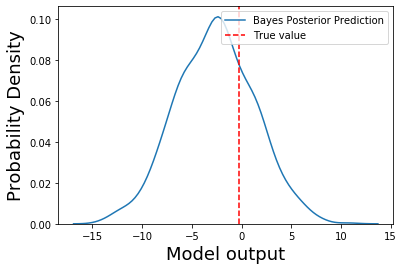

In [20]:
test_id = 10
plot_single_prediction(
    x_test[test_id, :][None, :],
    y_test[test_id].item(),
    hmc_mcmc_predictive
)

### The No-U-Turn Sampler (https://arxiv.org/abs/1111.4246)

In [21]:
nuts_kernel = NUTS(
    model=model,
)

nuts_mcmc_posterior = run_mcmc(
    kernel=nuts_kernel,
    model_args=(x_train, y_train),
    num_samples=num_samples,
    warmup_steps=None,
)

nuts_samples = sample_mcmc(nuts_mcmc_posterior)

Sample: 100%|██████████| 2000/2000 [03:24,  9.78it/s, step size=1.54e-01, acc. prob=0.926]


In [22]:
nuts_mcmc_posterior.summary()


                    mean       std    median      5.0%     95.0%     n_eff     r_hat
     intercept     -0.28      0.09     -0.28     -0.44     -0.14    577.04      1.00
         b_GRE      0.14      0.04      0.14      0.07      0.22    941.28      1.00
       b_TEOFL      0.11      0.04      0.11      0.04      0.17    880.00      1.00
  b_university      0.05      0.03      0.05      0.01      0.10    782.36      1.00
         b_SOP      0.02      0.03      0.02     -0.04      0.07   1358.96      1.00
         b_LOP      0.09      0.03      0.09      0.04      0.13   1495.05      1.00
        b_CGPA      0.51      0.05      0.52      0.44      0.60   1078.25      1.00
    b_research      0.22      0.05      0.22      0.14      0.30   1154.83      1.00
         sigma      0.42      0.02      0.42      0.39      0.44   1228.42      1.00

Number of divergences: 0


In [23]:
nuts_mcmc_predictive = Predictive(
    model,
    posterior_samples=nuts_samples,
    return_sites=('obs','_RETURN')
)
nuts_mcmc_predictive(x_test)

{'obs': tensor([[ 1.0824, -0.9862, -0.0700,  ...,  0.2822,  0.4024, -1.1817],
         [ 0.8801, -1.2278, -0.3160,  ...,  0.2724,  0.6103, -0.9956],
         [ 0.4737, -0.6385,  0.1250,  ...,  1.3370,  0.6010, -1.0423],
         ...,
         [ 0.2999, -1.5645, -0.6109,  ...,  0.6082, -0.7587, -1.3827],
         [ 0.6934, -0.8362, -0.6658,  ...,  0.1603,  0.2494, -0.8354],
         [ 0.9543, -0.6969, -0.6125,  ...,  1.2984,  0.3562, -1.2689]]),
 '_RETURN': tensor([[ 0.6735, -0.8022, -0.4702,  ...,  0.6530,  0.6223, -1.2205],
         [ 0.5999, -0.8744, -0.5087,  ...,  0.7426,  0.4973, -1.2174],
         [ 0.6459, -0.8583, -0.4891,  ...,  0.7799,  0.5433, -1.2233],
         ...,
         [ 0.6571, -0.8166, -0.4654,  ...,  0.6636,  0.5224, -1.2184],
         [ 0.7224, -0.7899, -0.4671,  ...,  0.6860,  0.5738, -1.2280],
         [ 0.6526, -0.7491, -0.3844,  ...,  0.6594,  0.5346, -1.1007]])}

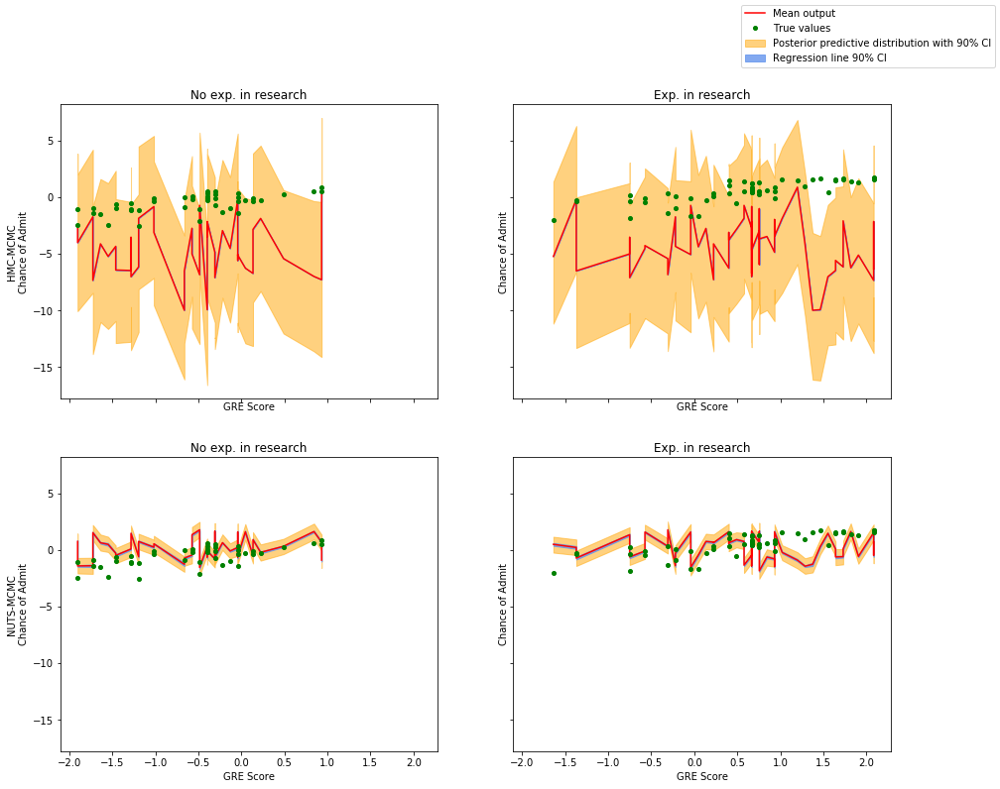

In [24]:
properties = {
    'x': 0,
    'x_label': "GRE Score",
    'y_label': "Chance of Admit",
    'category': 6,
    'category_labels': {
        0: "No exp. in research",
        1: "Exp. in research",
    }
}
predictors = {
    'HMC-MCMC': hmc_mcmc_predictive,
    'NUTS-MCMC': nuts_mcmc_predictive,
}
data = {
    'x': x_test,
    'y': y_test
}
plot_predictions(data, predictors, properties)

# Variational Inference estimation


In [25]:
display_sourcecode(model)

def model(x, y=None):
    intercept = pyro.sample("intercept", dist.Normal(beta[0], 10))
    b_GRE = pyro.sample("b_GRE", dist.Normal(beta[1], 1))
    b_TEOFL = pyro.sample("b_TEOFL", dist.Normal(beta[2], 1))
    b_university = pyro.sample("b_university", dist.Normal(beta[3], 1))
    b_SOP = pyro.sample("b_SOP", dist.Normal(beta[4], 1))
    b_LOP = pyro.sample("b_LOP", dist.Normal(beta[5], 1))
    b_CGPA = pyro.sample("b_CGPA", dist.Normal(beta[6], 1))
    b_research = pyro.sample("b_research", dist.Normal(beta[7], 1))

    sigma = pyro.sample("sigma", dist.Exponential(1))
    
    mean = (
            intercept +
            b_GRE * x[:, 0] +
            b_TEOFL * x[:, 1] +
            b_university * x[:, 2] +
            b_SOP * x[:, 3] +
            b_LOP * x[:, 4] +
            b_CGPA * x[:, 5] +
            b_research * x[:, 6]
    )
    with pyro.plate("data", x.shape[0]):
        pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
    return mean

In [26]:
def guide(x, y=None):
    loc = pyro.param('loc', torch.randn(8))
    scale = pyro.param('scale', torch.ones(8),
                               constraint=constraints.positive)
    b_GRE = pyro.sample("b_GRE", dist.Normal(loc[0], scale[0]))
    b_TEOFL = pyro.sample("b_TEOFL", dist.Normal(loc[1], scale[1]))
    b_university = pyro.sample("b_university", dist.Normal(loc[2], scale[2]))
    b_SOP = pyro.sample("b_SOP", dist.Normal(loc[3], scale[3]))
    b_LOP = pyro.sample("b_LOP", dist.Normal(loc[4], scale[4]))
    b_CGPA = pyro.sample("b_CGPA", dist.Normal(loc[5], scale[5]))
    b_research = pyro.sample("b_research", dist.Normal(loc[6], scale[6]))
    intercept = pyro.sample("intercept", dist.Normal(loc[7], scale[7]))

    sigma_mean = pyro.param(
        'sigma_mean',
        torch.ones(1),
        constraint=constraints.positive
    )
    sigma = pyro.sample("sigma", dist.Normal(sigma_mean, torch.Tensor([0.05])))

In [27]:
elbos, params = run_svi(model, guide, x_train, y_train)

Elbo loss: 8122.94142138958
Elbo loss: 609.2924468517303
Elbo loss: 323.7068657577038
Elbo loss: 262.78975999355316
Elbo loss: 246.37864497303963
Elbo loss: 256.27643555402756
Elbo loss: 248.87132307887077
Elbo loss: 260.10573157668114
Elbo loss: 256.06321012973785
Elbo loss: 253.61992526054382


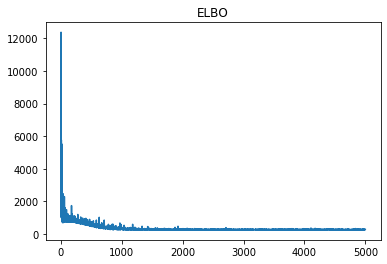

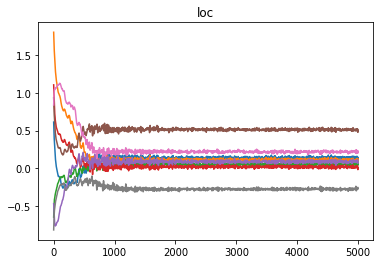

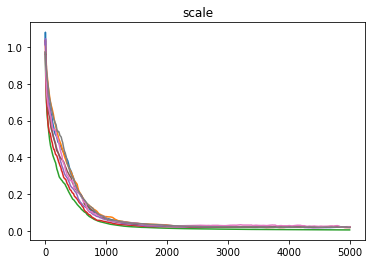

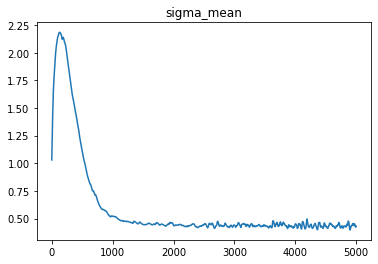

In [28]:
plt.plot(elbos)
plt.title('ELBO')
plt.show()

for param in params[0].keys():
    y = [d[param].detach().numpy() for d in params]
    plt.plot(y)
    plt.title(param)
    plt.show()

In [29]:
svi_param_store = dict(pyro.get_param_store())
for name, value in svi_param_store.items():
    print(name, value.detach().cpu())

loc tensor([ 0.1379,  0.1202,  0.0653,  0.0108,  0.0902,  0.5060,  0.2276, -0.2559])
scale tensor([0.0227, 0.0239, 0.0066, 0.0205, 0.0224, 0.0194, 0.0236, 0.0212])
sigma_mean tensor([0.4313])


In [30]:
display_sourcecode(SviPredictive)

class SviPredictive(Predictive):
    def __init__(self, *args, **kwards):
        super().__init__(*args, **kwards)

    def forward(self, *args, **kwargs):
        return {k: v.detach() for k, v in
                super().forward(*args, **kwargs).items()}

In [31]:
svi_predictive = SviPredictive(
    model,
    guide=guide,
    num_samples=num_samples,
    return_sites=('obs','_RETURN')
)
svi_predictive(x_test)

{'obs': tensor([[ 0.6479, -0.2884, -0.4968,  ...,  0.8522,  0.7021, -1.3381],
         [ 1.1110, -1.3630, -0.4835,  ...,  1.5431,  0.7036, -0.8855],
         [ 0.5069, -0.6154, -0.3153,  ...,  0.6224,  1.1356, -1.6439],
         ...,
         [ 1.1740,  0.0807,  0.3369,  ...,  0.9252,  1.0957, -0.7132],
         [ 1.1425, -1.2964,  0.0247,  ...,  0.7219,  0.2620, -0.7680],
         [ 0.6129, -1.0534, -0.0541,  ...,  0.6453,  0.8730, -1.4753]]),
 '_RETURN': tensor([[ 0.7654, -0.6978, -0.3785,  ...,  0.7359,  0.6641, -1.1346],
         [ 0.7885, -0.7451, -0.4045,  ...,  0.7526,  0.6715, -1.1991],
         [ 0.7612, -0.7972, -0.4159,  ...,  0.8053,  0.6095, -1.1886],
         ...,
         [ 0.7542, -0.8118, -0.4895,  ...,  0.6966,  0.6291, -1.2922],
         [ 0.6496, -0.7550, -0.4203,  ...,  0.7504,  0.5013, -1.0934],
         [ 0.8320, -0.7250, -0.3700,  ...,  0.7928,  0.7390, -1.1735]])}

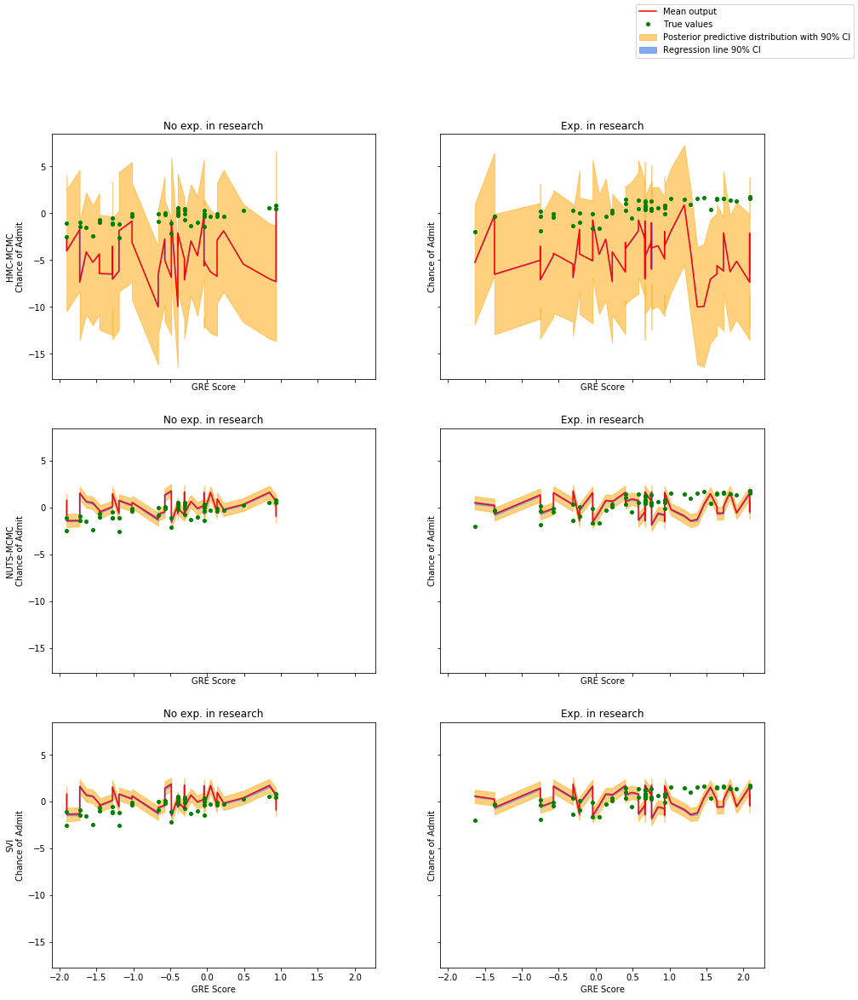

In [32]:
properties = {
    'x': 0,
    'x_label': "GRE Score",
    'y_label': "Chance of Admit",
    'category': 6,
    'category_labels': {
        0: "No exp. in research",
        1: "Exp. in research",
    }
}
predictors = {
    'HMC-MCMC': hmc_mcmc_predictive,
    'NUTS-MCMC': nuts_mcmc_predictive,
    'SVI': svi_predictive
}
data = {
    'x': x_test,
    'y': y_test
}
plot_predictions(data, predictors, properties)

In [33]:
display_sourcecode(sample_svi)

def sample_svi(model, guide, num_samples, x):
    return {
        k: v.reshape(num_samples).detach().cpu()
        for k, v in Predictive(
            model,
            guide=guide,
            num_samples=num_samples
        )(x).items() if k != "obs"
    }

In [34]:
svi_samples = sample_svi(
    model,
    guide,
    num_samples,
    x_test
)

In [35]:
print_summary(summary(svi_samples))

Site: intercept
{'mean': -0.2554112374782562, 'std': 0.021526120603084564, '5%': -0.29125604033470154, '95%': -0.21954981982707977}
Site: b_GRE
{'mean': 0.13770298659801483, 'std': 0.02346717193722725, '5%': 0.10048558562994003, '95%': 0.17658990621566772}
Site: b_TEOFL
{'mean': 0.11989793926477432, 'std': 0.02347417175769806, '5%': 0.08185875415802002, '95%': 0.1596173495054245}
Site: b_university
{'mean': 0.06519339233636856, 'std': 0.006681386381387711, '5%': 0.0543849915266037, '95%': 0.07625774294137955}
Site: b_SOP
{'mean': 0.01090735848993063, 'std': 0.020839018747210503, '5%': -0.023279551416635513, '95%': 0.04352552443742752}
Site: b_LOP
{'mean': 0.0896192267537117, 'std': 0.021993141621351242, '5%': 0.053465668112039566, '95%': 0.12556345760822296}
Site: b_CGPA
{'mean': 0.5046355724334717, 'std': 0.01992318406701088, '5%': 0.47223007678985596, '95%': 0.5371186137199402}
Site: b_research
{'mean': 0.2274189293384552, 'std': 0.024664256721735, '5%': 0.18703055381774902, '95%': 0

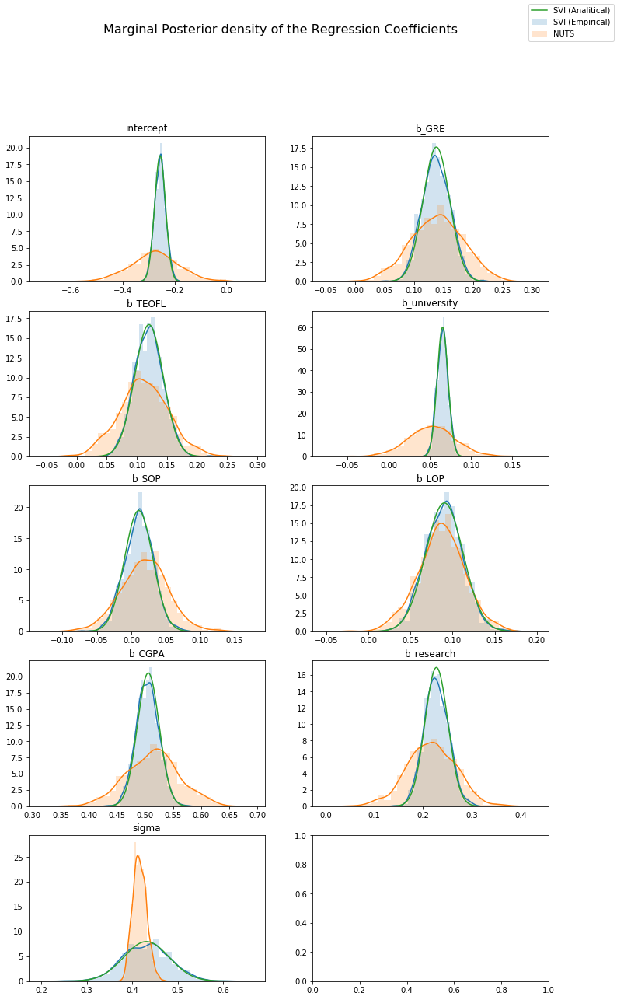

In [36]:
sites = [
    "intercept",
    "b_GRE",
    "b_TEOFL",
    "b_university",
    "b_SOP",
    "b_LOP",
    "b_CGPA",
    "b_research",
    "sigma"
]

sites_dist = {
    "intercept": norm(
        loc=svi_param_store['loc'].detach()[7].item(),
        scale=svi_param_store['scale'].detach()[7].item()
    ),
    "b_GRE": norm(
        loc=svi_param_store['loc'].detach()[0].item(),
        scale=svi_param_store['scale'].detach()[0].item()
    ),
    "b_TEOFL": norm(
        loc=svi_param_store['loc'].detach()[1].item(),
        scale=svi_param_store['scale'].detach()[1].item()
    ),
    "b_university": norm(
        loc=svi_param_store['loc'].detach()[2].item(),
        scale=svi_param_store['scale'].detach()[2].item()
    ), 
    "b_SOP": norm(
        loc=svi_param_store['loc'].detach()[3].item(),
        scale=svi_param_store['scale'].detach()[3].item()
    ),
    "b_LOP": norm(
        loc=svi_param_store['loc'].detach()[4].item(),
        scale=svi_param_store['scale'].detach()[4].item()
    ),
    "b_CGPA": norm(
        loc=svi_param_store['loc'].detach()[5].item(),
        scale=svi_param_store['scale'].detach()[5].item()
    ),
    "b_research": norm(
        loc=svi_param_store['loc'].detach()[6].item(),
        scale=svi_param_store['scale'].detach()[6].item()
    ),
    'sigma': norm(
        loc=svi_param_store['sigma_mean'].detach().item(),
        scale=0.05
    ),
}

samples = {
#     "HMC": hmc_samples,
    "NUTS": nuts_samples,
}

plot_mpd(sites, sites_dist, samples, svi_samples)

In [37]:
interactive_plot = interact_manual(
    make_interavtive,
    nd=IntSlider(min=10, max=len(y_train), step=5, value=30),
    ns=fixed(num_samples),
    data=fixed({
        'x_train': x_train,
        'y_train': y_train,
        'x_test': x_test,
        'y_test': y_test,
        }),
    samples=fixed(samples),
    model=fixed(model),
    guide=fixed(guide),
    sites=fixed(sites)
    )
interactive_plot;

interactive(children=(IntSlider(value=30, description='nd', max=400, min=10, step=5), Button(description='Run …

# I don't like the way we've handled `sigma`. Can we do something different?
Use Dirac Delta in the guide. It's implement as distribution in pyro - [Delta](http://docs.pyro.ai/en/stable/distributions.html#delta)

In [ ]:
display_sourcecode(model)

In [40]:
def guide(x, y=None):
    loc = pyro.param('loc', torch.randn(8))
    scale = pyro.param('scale', torch.ones(8),
                               constraint=constraints.positive)
    b_GRE = pyro.sample("b_GRE", dist.Normal(loc[0], scale[0]))
    b_TEOFL = pyro.sample("b_TEOFL", dist.Normal(loc[1], scale[1]))
    b_university = pyro.sample("b_university", dist.Normal(loc[2], scale[2]))
    b_SOP = pyro.sample("b_SOP", dist.Normal(loc[3], scale[3]))
    b_LOP = pyro.sample("b_LOP", dist.Normal(loc[4], scale[4]))
    b_CGPA = pyro.sample("b_CGPA", dist.Normal(loc[5], scale[5]))
    b_research = pyro.sample("b_research", dist.Normal(loc[6], scale[6]))
    intercept = pyro.sample("intercept", dist.Normal(loc[7], scale[7]))

    sigma_loc = pyro.param("drift_loc", lambda: torch.tensor(1.),
                           constraint=constraints.positive)
    pyro.sample("sigma", dist.Delta(sigma_loc))

In [41]:
elbos, params = run_svi(model, guide, x_train, y_train)
plt.plot(elbos)
plt.title('ELBO')
plt.show()

for param in params[0].keys():
    y = [d[param].detach().numpy() for d in params]
    plt.plot(y)
    plt.title(param)
    plt.show()

/usr/local/lib/python3.7/site-packages/pyro/util.py:208: UserWarning: Found non-auxiliary vars in guide but not model, consider marking these infer={'is_auxiliary': True}:
{'b_CGPA', 'b_TEOFL', 'b_SOP', 'b_GRE', 'b_LOP'}
  guide_vars - aux_vars - model_vars))
/usr/local/lib/python3.7/site-packages/pyro/util.py:210: UserWarning: Found vars in model but not guide: {'b_score2', 'b_score1'}
  warnings.warn("Found vars in model but not guide: {}".format(model_vars - guide_vars - enum_vars))
Elbo loss: 17851.973712146282
Elbo loss: 632.3761116266251
Elbo loss: 322.1653814315796


ValueError: The parameter scale has invalid values
    Trace Shapes:  
     Param Sites:  
              loc 8
            scale 8
    Sample Sites:  
       b_GRE dist |
            value |
     b_TEOFL dist |
            value |
b_university dist |
            value |

# Can I obtain in writting less code?
Yes, you can use [EasyGuide](http://docs.pyro.ai/en/stable/contrib.easyguide.html) 

In [ ]:
from pyro.contrib.easyguide import easy_guide

In [ ]:
@easy_guide(model)
def guide(self, x, y=None):
    loc = pyro.param('loc', torch.randn(8))
    scale = pyro.param('scale', torch.ones(8),
                               constraint=constraints.positive)
    b_GRE = pyro.sample("b_GRE", dist.Normal(loc[0], scale[0]))
    b_TEOFL = pyro.sample("b_TEOFL", dist.Normal(loc[1], scale[1]))
    b_university = pyro.sample("b_university", dist.Normal(loc[2], scale[2]))
    b_SOP = pyro.sample("b_SOP", dist.Normal(loc[3], scale[3]))
    b_LOP = pyro.sample("b_LOP", dist.Normal(loc[4], scale[4]))
    b_CGPA = pyro.sample("b_CGPA", dist.Normal(loc[5], scale[5]))
    b_research = pyro.sample("b_research", dist.Normal(loc[6], scale[6]))
    intercept = pyro.sample("intercept", dist.Normal(loc[7], scale[7]))

    self.map_estimate("sigma")

In [ ]:
elbos, params = run_svi(model, guide, x_train, y_train)
plt.plot(elbos)
plt.title('ELBO')
plt.show()

for param in params[0].keys():
    y = [d[param].detach().numpy() for d in params]
    plt.plot(y)
    plt.title(param)
    plt.show()

Also check out the [Group](http://docs.pyro.ai/en/stable/contrib.easyguide.html#group) class and [how to use it with `EasyGuide`](https://pyro.ai/examples/easyguide.html#Using-EasyGuide).

# And maybe can I use some non-probabilistic models/modules within my probabilistic model and train the parameters simultanously?
Yes, as long as they are `torch` modules

In [38]:
def model(x, y=None):
    # summarize all the student's scores (GRE, TEOFL, SOP, LOP, CGPA) with 2 dimensions
    dimensionality_reduction = nn.Linear(5, 2)
    pyro.module('dimensionality_reduction', dimensionality_reduction)  
    x_score = dimensionality_reduction(x[:, [0, 1, 3, 4, 5]])

    intercept = pyro.sample("intercept", dist.Normal(0, 10))
    b_university = pyro.sample("b_university", dist.Normal(0, 1))
    b_research = pyro.sample("b_research", dist.Normal(0, 1))
    b_score1 = pyro.sample("b_score1", dist.Normal(0, 1))
    b_score2 = pyro.sample("b_score2", dist.Normal(0, 1))

    sigma = pyro.sample("sigma", dist.Exponential(1))
    
    mean = (
            intercept +
            b_university * x[:, 2] +
            b_research * x[:, 6] +
            b_score1 * x_score[:, 0] +
            b_score2 * x_score[:, 1]
    )
    with pyro.plate("data", x.shape[0]):
        pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
    return mean

In [39]:
@easy_guide(model) # pyro.module can be used without EasyGuide
def guide(self, x, y=None):
    loc = pyro.param('loc', torch.randn(5))
    scale = pyro.param('scale', torch.ones(5),
                               constraint=constraints.positive)
    b_university = pyro.sample("b_university", dist.Normal(loc[0], scale[0]))
    b_research = pyro.sample("b_research", dist.Normal(loc[1], scale[1]))
    intercept = pyro.sample("intercept", dist.Normal(loc[2], scale[2]))
    b_score1 = pyro.sample("b_score1", dist.Normal(loc[3], scale[3]))
    b_score2 = pyro.sample("b_score2", dist.Normal(loc[4], scale[4]))

    self.map_estimate("sigma")

NameError: name 'easy_guide' is not defined

In [ ]:
elbos, params = run_svi(model, guide, x_train, y_train, loss=TraceGraph_ELBO())
print(dict(pyro.get_param_store()))
plt.plot(elbos)
plt.title('ELBO')
plt.show()

for param in params[0].keys():
    y = [d[param].detach().reshape(-1).numpy() for d in params]
    plt.plot(y)
    plt.title(param)
    plt.show()

Anybody has noted another difference? The default loss, which was `Trace_ELBO()`, has been replaced with `TraceGraph_ELBO()`. Adding non-probabilist parts is something else from the perspective of `ELBO` and `SVI` to the models we have seen before. We need to track the whole computational `Graph` and that is what `TraceGraph_ELBO()` id doing. We will elaborate on losses implemented in `pyro` later on.

# Do I have to use `torch.nn.Module` to optimize a single parameter?
No, you can use [`pyro.deterministic`](http://docs.pyro.ai/en/stable/primitives.html#pyro.primitives.deterministic) for that purpose (and for much more!)

There is suspicion that universities were overrated. Let's decrease their rates. Estimate to what extend.

In [ ]:
def model(x, y=None):
    decrease = pyro.param(
        'decrease',
        torch.Tensor([3]),
        constraint=constraints.interval(1, 5)
    )
    
    uni = pyro.deterministic('uni', torch.clamp(x[:, 2] - decrease, min=0.)) # the operation has to track gradient!
    
    intercept = pyro.sample("intercept", dist.Normal(0, 10))
    b_GRE = pyro.sample("b_GRE", dist.Normal(0, 1))
    b_TEOFL = pyro.sample("b_TEOFL", dist.Normal(0, 1))
    b_university = pyro.sample("b_university", dist.Normal(0, 1))
    b_SOP = pyro.sample("b_SOP", dist.Normal(0, 1))
    b_LOP = pyro.sample("b_LOP", dist.Normal(0, 1))
    b_CGPA = pyro.sample("b_CGPA", dist.Normal(0, 1))
    b_research = pyro.sample("b_research", dist.Normal(0, 1))

    sigma = pyro.sample("sigma", dist.Exponential(1))
    
    mean = (
            intercept +
            b_GRE * x[:, 0] +
            b_TEOFL * x[:, 1] +
            b_university * uni +
            b_SOP * x[:, 3] +
            b_LOP * x[:, 4] +
            b_CGPA * x[:, 5] +
            b_research * x[:, 6]
    )
    with pyro.plate("data", x.shape[0]):
        pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
    return mean

In [ ]:
def guide(x, y=None):  
    loc = pyro.param('loc', torch.randn(8))
    scale = pyro.param('scale', torch.ones(8),
                               constraint=constraints.positive)
    b_GRE = pyro.sample("b_GRE", dist.Normal(loc[0], scale[0]))
    b_TEOFL = pyro.sample("b_TEOFL", dist.Normal(loc[1], scale[1]))
    b_university = pyro.sample("b_university", dist.Normal(loc[2], scale[2]))
    b_SOP = pyro.sample("b_SOP", dist.Normal(loc[3], scale[3]))
    b_LOP = pyro.sample("b_LOP", dist.Normal(loc[4], scale[4]))
    b_CGPA = pyro.sample("b_CGPA", dist.Normal(loc[5], scale[5]))
    b_research = pyro.sample("b_research", dist.Normal(loc[6], scale[6]))
    intercept = pyro.sample("intercept", dist.Normal(loc[7], scale[7]))

    sigma_loc = pyro.param("drift_loc", lambda: torch.tensor(1.),
                           constraint=constraints.positive)
    pyro.sample("sigma", dist.Delta(sigma_loc))

In [ ]:
elbos, params = run_svi(model, guide, x_train, y_train)
print(dict(pyro.get_param_store()))
plt.plot(elbos)
plt.title('ELBO')
plt.show()

for param in params[0].keys():
    y = [d[param].detach().reshape(-1).numpy() for d in params]
    plt.plot(y)
    plt.title(param)
    plt.show()

Remarks:
- `TraceGraph_ELBO` was not needed here, but be carefull
- `pyro.deterministic` can be invoked in the `guide`
- when a value returned by `pyro.detereministic` is passed to sample other sites, then we need (or are really likely to want) to perform the operation in the guide. Then we perfom the operation without wrapping it with `pyro.detereministic`

Are you familiar with the avialible constraints? You can check them [here](http://docs.pyro.ai/en/stable/_modules/torch/distributions/constraints.html)

# Can we vectorize it?

# And why not to use Class?

In [45]:
class BayesianLinearRegression(nn.Module):
    
    def __init__(self, n_input, intercept=True):
        super().__init__()
        self.n_input = n_input
        self.has_intercept = intercept
        
    def model(self, x, y=None):
        if self.has_intercept:
            intercept = pyro.sample(
                'intercept',
                dist.Normal(0., 10.).expand([1]).to_event(1)
            )
        else:
            intercept = torch.Tensor([0.])
        coefficients = pyro.sample(
            'coefficients',
            dist.Normal(0., 1.).expand([1, self.n_input]).to_event(2)
        )
        sigma = pyro.sample("sigma", dist.Uniform(0., 10.))
        mean = coefficients @ x.t() + intercept
        with pyro.plate("data", x.shape[0]):
            obs = pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
        return mean
    
    def forward(self, *args, **kwargs):
        return self.model(*args, **kwargs)
    
    def guide(self, x, y=None):
        sigma_loc = pyro.param(
            'sigma_loc',
            torch.rand(1),
            constraint=constraints.positive
        )
        loc = pyro.param(
            'loc',
            torch.zeros([1, self.n_input])
        )
        scale = pyro.param(
            'scale',
            torch.ones([1, self.n_input]),
            constraint=constraints.positive
        )
        if self.has_intercept:
            intercept_loc = pyro.param('intercept_loc', torch.zeros(1))
            intercept_scale = pyro.param(
                'intercept_scale',
                torch.ones(1),
                constraint=constraints.positive
            )
            pyro.sample(
                'intercept',
                dist.Normal(intercept_loc, intercept_scale).to_event(1)
            )
        
        pyro.sample('coefficients', dist.Normal(loc, scale).to_event(2))
        pyro.sample('sigma', dist.Normal(sigma_loc, torch.Tensor([0.05])))

m = BayesianLinearRegression(7, True)

adam = pyro.optim.Adam({"lr": 0.03})
elbos, params = run_svi(m, m.guide, x_train, y_train, adam)

print(dict(pyro.get_param_store()))

Elbo loss: 113733.85619193316


tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

Elbo loss: 4440.942346096039


tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

Elbo loss: 5610.813464999199


tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

Elbo loss: 1215.0766047239304


tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

Elbo loss: 1161.3674011230469


tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

Elbo loss: 701.1135716438293


tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

Elbo loss: 612.2037513256073


tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

Elbo loss: 766.3914685249329


tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

Elbo loss: 339.8160140514374


tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

Elbo loss: 518.1093589067459


tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

tensor([ 1.1933, -0.0833,  0.4841, -1.5017, -0.2251, -0.3670,  1.0515, -1.4308,
        -1.8563, -0.9343,  0.4132, -0.2251, -0.0833,  0.4841,  0.4132, -0.5797,
         0.4841, -0.1542, -0.5797,  0.3423,  0.2713,  1.1933,  0.6969,  0.6969,
        -0.1542, -1.3599, -0.0123, -1.0053,  0.2713,  0.6969,  1.5480, -0.6506,
        -0.2251, -0.4379, -0.0833,  0.6969, -0.1542,  0.8387,  0.4132,  1.4061,
         1.6189, -1.1471, -1.0053, -1.2889, -0.0123, -0.5088,  0.0586,  0.9806,
        -1.6436,  1.7607, -0.5797,  0.0586, -2.0691,  0.2004, -0.2251, -0.5797,
         1.0515, -0.2960, -0.5797, -0.0123, -1.4308,  1.4770,  0.5550,  0.1295,
         1.2643,  0.9806,  0.4841, -0.4379,  0.4132, -0.7925, -0.7216, -0.0833,
         0.2713, -0.2960, -0.5088, -0.7216,  0.7678, -0.7216, -2.4237, -0.7216,
        -0.5797,  0.2004, -1.2889, -0.6506, -0.5797,  0.0586,  0.2713,  0.2004,
         1.2643, -1.0053, -1.7854,  0.0586, -1.9272, -0.5088, -1.2889,  0.6260,
         1.1933, -0.0123, -1.4308,  1.68

What is `to_event()`? Check [documentation of `TorchDistribution` (paragraph about Tensor Shapes)](http://docs.pyro.ai/en/stable/distributions.html#torchdistribution) and the [Tutorial on Tensor shapes in Pyro](https://pyro.ai/examples/tensor_shapes.html)

Remarks:
- `pyro.param` can take argument `event_dim` which has the same meaning as `to_event()` for distribtuions.

# But can I initialize stuff in the constructor?
Yes - use [`PyroModule`](http://docs.pyro.ai/en/stable/nn.html#pyro.nn.module.PyroModule)

In [ ]:
from pyro.nn import PyroModule, PyroSample

In [ ]:
class BayesianLinearRegression(PyroModule):
    
    def __init__(self, n_input, intercept=True):
        super().__init__()
        self.linear = PyroModule()
        self.linear.coefficients = PyroSample(
            dist.Normal(0., 1.).expand([1, n_input]).to_event(2)
        )
        if intercept:
            self.linear.intercept = PyroSample(
                dist.Normal(0., 10.).expand([1]).to_event(1)
            )
        else:
            self.linear.intercept = torch.Tensor([0.])
        self.n_input = n_input
        self.has_intercept = intercept
        
    def model(self, x, y=None):
        sigma = pyro.sample("sigma", dist.Uniform(0., 10.))
        mean = self.linear.coefficients @ x.t() + self.linear.intercept
        with pyro.plate("data", x.shape[0]):
            obs = pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
        return mean
    
    def forward(self, *args, **kwargs):
        return self.model(*args, **kwargs)

# But do I have to implement the `forward` method for each type of module?
No! Inherit it from [`torch.nn` modules](https://pytorch.org/docs/stable/nn.html).
Here we will use [`torch.nn.Linear`](https://pytorch.org/docs/stable/nn.html#linear).

In [ ]:
class BayesianLinearRegression(PyroModule):
    
    def __init__(self, n_input, intercept=True):
        super().__init__()
        self.linear = PyroModule[nn.Linear](n_input, 1, intercept)
        self.linear.weight = PyroSample(
            dist.Normal(0., 1.).expand([1, n_input]).to_event(2)
        )
        if intercept:
            self.linear.bias = PyroSample(
                dist.Normal(0., 10.).expand([1]).to_event(1)
            )
        self.n_input = n_input
        self.has_intercept = intercept
        
    def model(self, x, y=None):
        sigma = pyro.sample("sigma", dist.Uniform(0., 10.))
        mean = self.linear(x).squeeze(-1)
        with pyro.plate("data", x.shape[0]):
            obs = pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
        return mean
    
    def forward(self, *args, **kwargs):
        return self.model(*args, **kwargs)

# But how to write guides for such models? Sites have no names.
Use [AutoGuide](http://docs.pyro.ai/en/stable/infer.autoguide.html)

In [ ]:
from pyro.infer.autoguide import AutoDiagonalNormal

In [ ]:
class BayesianLinearRegression(PyroModule):
    
    def __init__(self, n_input, intercept=True):
        super().__init__()
        self.linear = PyroModule[nn.Linear](n_input, 1, intercept)
        self.linear.weight = PyroSample(
            dist.Normal(0., 1.).expand([1, n_input]).to_event(2)
        )
        if intercept:
            self.linear.bias = PyroSample(
                dist.Normal(0., 10.).expand([1]).to_event(1)
            )
        self.n_input = n_input
        self.has_intercept = intercept
        
    def model(self, x, y=None):
        sigma = pyro.sample("sigma", dist.Uniform(0., 10.))
        mean = self.linear(x).squeeze(-1)
        with pyro.plate("data", x.shape[0]):
            obs = pyro.sample("obs", dist.Normal(mean, sigma), obs=y)
        return mean
    
    def forward(self, *args, **kwargs):
        return self.model(*args, **kwargs)

m = BayesianLinearRegression(7, False)
guide = AutoDiagonalNormal(m)

adam = pyro.optim.Adam({"lr": 0.03})
elbos, params = run_svi(m, guide, x_train, y_train, adam)


print(dict(pyro.get_param_store()))

`AutoGuide` can be used with any model.

If you use `AutoGuide` you can detach params with a single command

In [ ]:
guide.requires_grad_(False)
print(dict(pyro.get_param_store()))

You can investigate the distribution of params by calling the `quantiles()` method of `guide`.

In [ ]:
guide.quantiles([0.25, 0.5, 0.75])

### How about more sofisticated guides than those in `pyro.infer.autoguide`?

In [ ]:
display_sourcecode(pyro.infer.autoguide)

You can use [`AutoGuideList`](http://docs.pyro.ai/en/stable/infer.autoguide.html#autoguidelist) with [`poutine.block` primitive](http://docs.pyro.ai/en/stable/poutine.html#pyro.poutine.handlers.block) to use the avialible `AutoGuide`s as building blocks.

# What else can be helpfull in the world of `pyro`?

#### [`ParamStore` class](http://docs.pyro.ai/en/stable/parameters.html)
Gives convenient access to param_store.

#### [`to_pyro_module_` function](http://docs.pyro.ai/en/stable/nn.html#pyro.nn.module.to_pyro_module_)
Converts an ordinary `torch.nn.Module` instance to a `PyroModule` in-place.

Priors need to be set manually.

In [ ]:
from pyro.nn.module import to_pyro_module_, PyroModule, PyroSample

In [ ]:
model = nn.Sequential(
    nn.Linear(28 * 28, 100),
    nn.Sigmoid(),
    nn.Linear(100, 100),
    nn.Sigmoid(),
    nn.Linear(100, 10),
)
to_pyro_module_(model)

for m in model.modules():
    for name, value in list(m.named_parameters(recurse=False)):
        setattr(m, name, PyroSample(prior=dist.Normal(0, 1)
                                              .expand(value.shape)
                                              .to_event(value.dim())))
guide = AutoDiagonalNormal(model)

# Is there anything more to explore in `pyro.infer`?

## Inference methods/models

### SVI with [ELBO](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.elbo)

There is much more to be done with ELBO than `Trace_ELBO` and `TraceGraphELBO`! Choose your ELBO wisely.

### Estimation with [Importance Sampling](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.importance)
Mind that `guide` has differt meaning than in SVI.

### [Reweighted Wake-Sleep](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.rws)
Check out [the paper](https://arxiv.org/pdf/1406.2751.pdf) for details.

Mind that `guide` (probably) has differt meaning than in SVI.

### [Sequential Monte Carlo](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.smcfilter)
Check out [a short document (142 pages)](http://hedibert.org/wp-content/uploads/2013/12/UPCcourse-handouts.pdf) (published as course material for [Markov Chain Monte Carlo and Sequential Monte Carlo Methods
in Dynamic Models and Stochastic Volatility Models Tutorial](http://hedibert.org/markov-chain-monte-carlo-and-sequential-monte-carlo-methods-in-dynamic-models-and-stochastic-volatility-models/) by [Prof. Hedibert Freitas Lopes](http://hedibert.org/)) relating SMC with MCMC

Mind that `guide` has differt meaning than in SVI.

### [Stein Methods](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.svgd)
Check out [the paper](https://arxiv.org/pdf/1608.04471.pdf) for details.

Models have to be fully vectorized and may only contain continuous latent variables.

The `guide` is replaced by `kernel`.

### [Energy Statistics](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.energy_distance)
Check out [the paper](https://www.sciencedirect.com/science/article/pii/S0378375813000633) for details.

A "Likelihood free" method.

### [Inference for discrete sites](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.discrete)
Examples of using `TraceEnumSample_ELBO`, `@infer_discrete` decorator and `@config_enumerate` decorator.

## [Inference Utilities](http://docs.pyro.ai/en/stable/inference_algos.html#module-pyro.infer.predictive)

Such as:
- `Predictive`
- `EmpiricalMarginal` - Marginal distribution over a single site
and more

## [Reparameterizers](http://docs.pyro.ai/en/stable/infer.reparam.html#module-pyro.infer.reparam)
*Reparameterising a probabilistic model means expressing it in terms of new variables defined by abijective transformation of the original variables of interest. The reparameterised model expressesthe same statistical assumptions as the original, but can have drastically different posterior geometry,with significant implications for both variational and sampling-based inference algorithms.*

For more details check [the paper](https://arxiv.org/pdf/1906.03028.pdf).

Contains utilities such as `ConjugateReparam` wich alows to implement conjugate posterior to be applied with data.

To use it, call [`pyro.poutine.reparam'](http://docs.pyro.ai/en/stable/poutine.html#pyro.poutine.handlers.reparam)